## Transfer Learning (SSD v1 MobileNet)


## 1. Install required libraries

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning


In [2]:
%tensorflow_version 1.x  # Version 1 is better suited for transfer learning
!pip show tensorflow

`%tensorflow_version` only switches the major version: 1.x or 2.x.
You set: `1.x  # Version 1 is better suited for transfer learning`. This will be interpreted as: `1.x`.


TensorFlow 1.x selected.
Name: tensorflow
Version: 1.15.2
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /tensorflow-1.15.2/python3.6
Requires: wrapt, protobuf, tensorflow-estimator, tensorboard, google-pasta, gast, astor, absl-py, keras-preprocessing, opt-einsum, termcolor, six, numpy, grpcio, keras-applications, wheel
Required-by: stable-baselines, magenta, fancyimpute


In [3]:
!pip install tf_slim   # Dependency. Removed from recent versions of tensorflow

     |████████████████████████████████| 358kB 2.7MB/s 


## 2. Clone the tensorflow github repo. Contains requirements to run and train pre-trained models.

In [ ]:
!git clone https://github.com/tensorflow/models.git # Import required models from Github

fatal: destination path 'models' already exists and is not an empty directory.


## 3. Download and install Tensorboard to track the model training in real-time.

In [ ]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2020-08-08 10:37:18--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 54.80.22.251, 52.1.26.21, 35.153.26.168, ...
Connecting to bin.equinox.io (bin.equinox.io)|54.80.22.251|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13773305 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip.2’

ngrok-stable-linux- 100%[===================>]  13.13M  4.97MB/s    in 2.6s    

2020-08-08 10:37:21 (4.97 MB/s) - ‘ngrok-stable-linux-amd64.zip.2’ saved [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


#### Create Log directory and enable Tensorboard.

In [ ]:
#the logs that are created while training 
LOG_DIR = "/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained"
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)
get_ipython().system_raw('./ngrok http 6006 &')
#The link to tensorboard.
#works after the training starts.
!curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

https://2de509e38ea4.ngrok.io


#### Compile Protobuf and and change Python path.

In [ ]:
%ls

a3c_blogpost/        cvt_text/       lstm_object_detection/  rebar/
adversarial_text/    deeplab/        marco/                  setup.py
attention_ocr/       deep_speech/    nst_blogpost/           slim/
audioset/            delf/           object_detection/       vid2depth/
autoaugment/         efficient-hrl/  pcl_rl/
cognitive_planning/  lfads/          README.md


In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/slim/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'
!python object_detection/builders/model_builder_test.py

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research


## 4. Generate tf-records

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning
%ls

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning
models/  ngrok*  ngrok-stable-linux-amd64.zip


In [ ]:
%mkdir -p models/bdd/data

In [ ]:
%cd models/bdd/data

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data


In [ ]:
# Upload train.csv and test.csv
from google.colab import files
uploaded = files.upload()


Saving test_labels.csv to test_labels.csv
Saving train_labels.csv to train_labels.csv
Saving val_labels.csv to val_labels.csv


In [ ]:
%ls
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/support_files

models/  ngrok*  ngrok-stable-linux-amd64.zip  support_files/
/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/support_files


In [ ]:
# Upload generate_tfrecord.py
from google.colab import files
uploaded = files.upload()

Saving generate_tfrecord.py to generate_tfrecord.py


In [ ]:
!python generate_tfrecord.py --csv_input=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/train_labels.csv  --output_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/train.record --image_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/data/train
!python generate_tfrecord.py --csv_input=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/test_labels.csv  --output_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/test.record --image_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/data/test




W0803 11:43:54.282433 140426250286976 module_wrapper.py:139] From generate_tfrecord.py:114: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0803 11:43:55.733657 140426250286976 module_wrapper.py:139] From generate_tfrecord.py:73: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/train.record


W0803 12:01:43.162270 140694352639872 module_wrapper.py:139] From generate_tfrecord.py:114: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0803 12:01:43.337180 140694352639872 module_wrapper.py:139] From generate_tfrecord.py:73: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/test.record


## 5. Download pre-trained model checkpoint

Model: SSD MobileNet Coco v1

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models

import os
import shutil
import glob
import urllib
import tarfile
from requests import get

MODEL = 'ssd_mobilenet_v1_coco_2017_11_17'
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = 'pretrained_model'

if not (os.path.exists(MODEL_FILE)):
  with open(MODEL_FILE, "wb") as file:
    # get request
    response = get(DOWNLOAD_BASE + MODEL_FILE)
    # write to file
    file.write(response.content)
    #opener = urllib.URLopener()
    #opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
  shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models


In [ ]:
%ls

AUTHORS  CODEOWNERS  CONTRIBUTING.md  LICENSE    orbit/             README.md
bdd/     community/  ISSUES.md        official/  pretrained_model/  research/


## 6. Modify the config file

In [ ]:
# Upload pbtxt labels file
# Upload train.csv and test.csv
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data
from google.colab import files
uploaded = files.upload()

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data


Saving object_detection.pbtxt to object_detection.pbtxt


In [ ]:
# Upload SSD Config file
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data
from google.colab import files
uploaded = files.upload()

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data


Saving ssd_mobilenet_v1_coco.config to ssd_mobilenet_v1_coco.config


In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/
!protoc object_detection/protos/*.proto --python_out=.
#!export PYTHONPATH=$PYTHONPATH: /usr/local/lib/python3.6/dist-packages/tensorflow/models/research/:/usr/local/lib/python3.6/dist-packages/tensorflow/models/research/slim
#!pwd
#!python /usr/local/lib/python3.6/dist-packages/tensorflow/models/research/object_detection/builders/model_builder_test.py
#!python setup.py build
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'

# Edit Pipeline 
import tensorflow as tf
from google.protobuf import text_format
from object_detection.protos import pipeline_pb2

pipeline = pipeline_pb2.TrainEvalPipelineConfig()                                                                                                                                                                                                          
config_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/ssd_mobilenet_v1_coco.config'
with tf.gfile.GFile( config_path, "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline)

pipeline.train_input_reader.tf_record_input_reader.input_path[:] = ['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/train.record'] 
pipeline.train_input_reader.label_map_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/object_detection.pbtxt'
pipeline.eval_input_reader[0].tf_record_input_reader.input_path[:] = ['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/test.record'] 
pipeline.eval_input_reader[0].label_map_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/object_detection.pbtxt'
pipeline.train_config.fine_tune_checkpoint = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/pretrained_model/model.ckpt'
pipeline.train_config.num_steps = 15000
pipeline.model.ssd.num_classes = 10
pipeline.eval_config.num_examples = 500

config_text = text_format.MessageToString(pipeline)                                                                                                                                                                                                        
with tf.gfile.Open( config_path, "wb") as f:                                                                                                                                                                                                                       
    f.write(config_text)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research


## 7. Train Model

In [ ]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/model_main.py \
    --logtostderr \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/ssd_mobilenet_v1_coco.config \
    --model_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained_new \
    --num_train_steps=15000 \
    --num_eval_steps=300

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research
W0808 19:41:48.358959 139644515485568 model_lib.py:758] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: 15000
I0808 19:41:48.359164 139644515485568 config_util.py:552] Maybe overwriting train_steps: 15000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0808 19:41:48.359259 139644515485568 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0808 19:41:48.359334 139644515485568 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0808 19:41:48.359429 139644515485568 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0808 19:41:48.359536 139644515485568 model_lib.py:774] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_ep

In [ ]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/legacy/train.py \
    --logtostderr \
    --train_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/ssd_mobilenet_v1_coco.config

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research
Instructions for updating:
Use object_detection/model_main.py.
W0808 11:03:14.545358 139821216720768 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/absl/app.py:250: main (from __main__) is deprecated and will be removed in a future version.
Instructions for updating:
Use object_detection/model_main.py.
Instructions for updating:
Please switch to tf.train.create_global_step
W0808 11:03:14.571096 139821216720768 deprecation.py:323] From /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/legacy/trainer.py:265: create_global_step (from tf_slim.ops.variables) is deprecated and will be removed in a future version.
Instructions for updating:
Please switch to tf.train.create_global_step
W0808 11:03:14.600754 139821216720768 dataset_builder.py:83] num_readers has been reduced to 1 to match input file shards.
Instructions for updating:
Use `tf.data.Data

In [4]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/model_main.py \
    --logtostderr \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/faster_rcnn_resnet101_kitti.config \
    --model_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained_new \
    --checkpoint_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained_new \
    --run_once=True

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research
Traceback (most recent call last):
  File "/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/model_main.py", line 25, in <module>
    from object_detection import model_lib
ModuleNotFoundError: No module named 'object_detection'


In [1]:
%load_ext tensorboard

%tensorboard --logdir "/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/trained/"

<IPython.core.display.Javascript object>

## 8. Save and export trained model/checkpoint.

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models


In [ ]:
%ls

AUTHORS     community/       LICENSE    pretrained_model/  trained/
bdd/        CONTRIBUTING.md  official/  README.md
CODEOWNERS  ISSUES.md        orbit/     research/


In [ ]:
import os

#Identify the latest trained model
lst = os.listdir('trained')
lf = filter(lambda k: 'model.ckpt-' in k, lst)
last_model = sorted(lf)[-1].replace('.meta', '')
os.environ['last_model']=last_model

# Export trained model
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/ssd_mobilenet_v1_coco.config \
    --output_directory=fine_tuned_model \
    --trained_checkpoint_prefix=trained/$last_model

Instructions for updating:
Please use `layer.__call__` method instead.
W0804 12:40:52.665696 140236508247936 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0804 12:40:53.983970 140236508247936 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0804 12:40:54.020632 140236508247936 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0804 12:40:54.055165 140236508247936 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv befo

## 9. Test the model

In [ ]:
# This is needed to display the images.
%matplotlib inline
import pathlib
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

Then we need to tell what model to download, input the number of classes our trained model, and set the path to the frozen detection graph

In [ ]:
# What model to download.
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/fine_tuned_model' + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/data/object_detection.pbtxt'

NUM_CLASSES = 10

In [ ]:
print(PATH_TO_CKPT)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/fine_tuned_model/frozen_inference_graph.pb


In [ ]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

In [ ]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

In [ ]:
print(category_index)

{1: {'id': 1, 'name': 'traffic light'}, 2: {'id': 2, 'name': 'traffic sign'}, 3: {'id': 3, 'name': 'car'}, 4: {'id': 4, 'name': 'person'}, 5: {'id': 5, 'name': 'bus'}, 6: {'id': 6, 'name': 'truck'}, 7: {'id': 7, 'name': 'rider'}, 8: {'id': 8, 'name': 'bike'}, 9: {'id': 9, 'name': 'motor'}, 10: {'id': 10, 'name': 'train'}}


In [ ]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)
# For the sake of simplicity we will use only 5 images:
# from image1.jpg
# to image5.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, 'image{}.jpg'.format(i)) for i in range(1, 9) ]

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

In [ ]:
print(TEST_IMAGE_PATHS)

['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image1.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image2.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image3.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image4.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image5.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image6.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image7.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/bdd/images/test/image8.jpg']


In [ ]:
def run_inference_for_single_image(image, graph):
  with graph.as_default():
    with tf.Session() as sess:
      # Get handles to input and output tensors
      ops = tf.get_default_graph().get_operations()
      all_tensor_names = {output.name for op in ops for output in op.outputs}
      tensor_dict = {}
      for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
      ]:
        tensor_name = key + ':0'
        if tensor_name in all_tensor_names:
          tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
              tensor_name)
      if 'detection_masks' in tensor_dict:
        # The following processing is only for single image
        detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
        detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
        # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
        real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
        detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
        detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
            detection_masks, detection_boxes, image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(
            tf.greater(detection_masks_reframed, 0.5), tf.uint8)
        # Follow the convention by adding back the batch dimension
        tensor_dict['detection_masks'] = tf.expand_dims(
            detection_masks_reframed, 0)
      image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

      # Run inference
      output_dict = sess.run(tensor_dict,
                             feed_dict={image_tensor: np.expand_dims(image, 0)})

      # all outputs are float32 numpy arrays, so convert types as appropriate
      output_dict['num_detections'] = int(output_dict['num_detections'][0])
      output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
      output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
      output_dict['detection_scores'] = output_dict['detection_scores'][0]
      if 'detection_masks' in output_dict:
        output_dict['detection_masks'] = output_dict['detection_masks'][0]
  return output_dict

In [ ]:
plt.close('all')

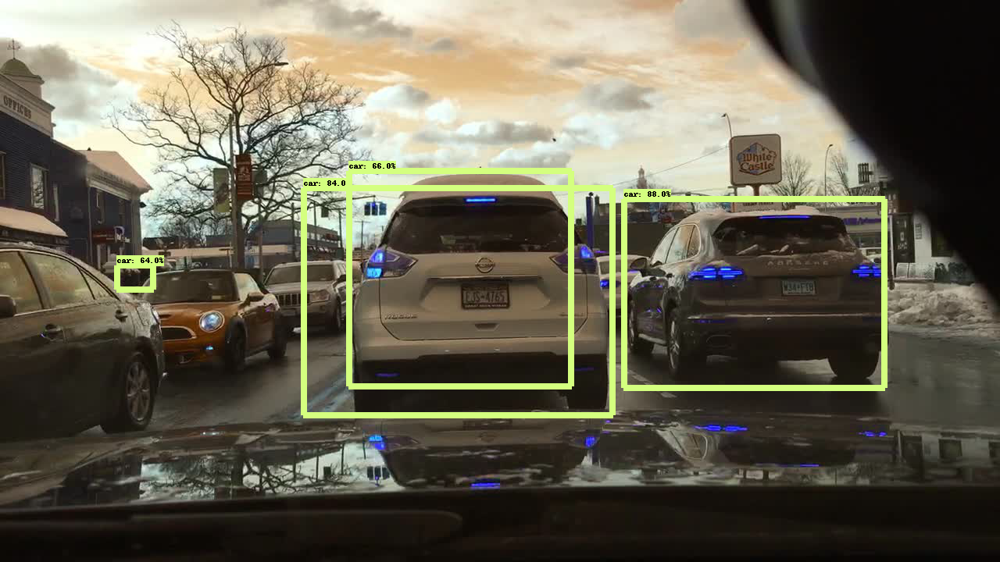

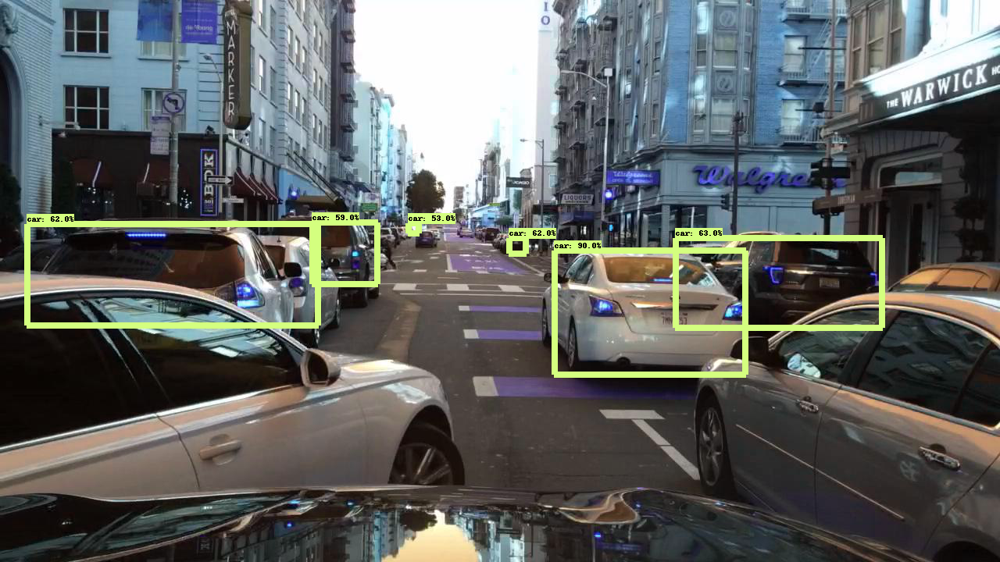

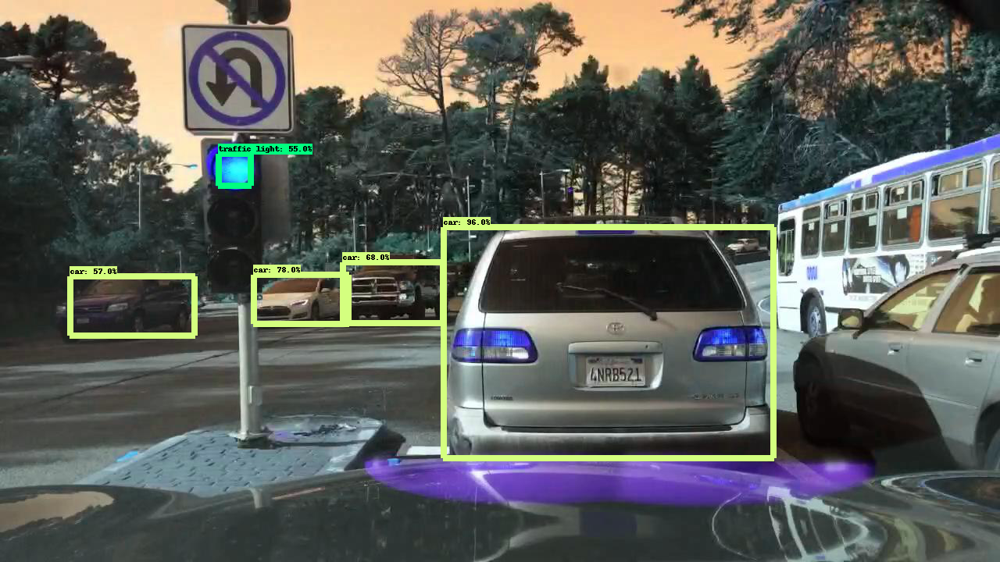

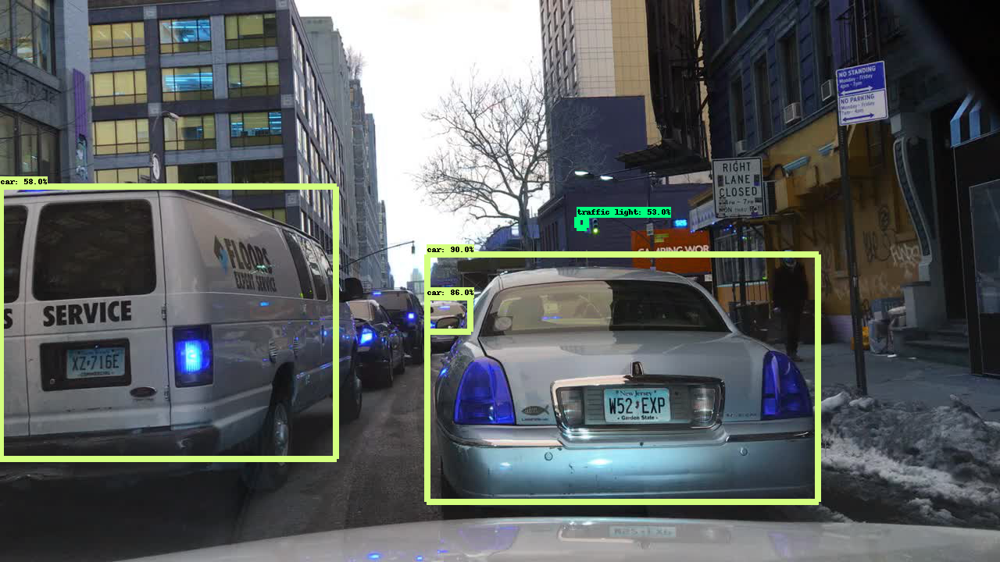

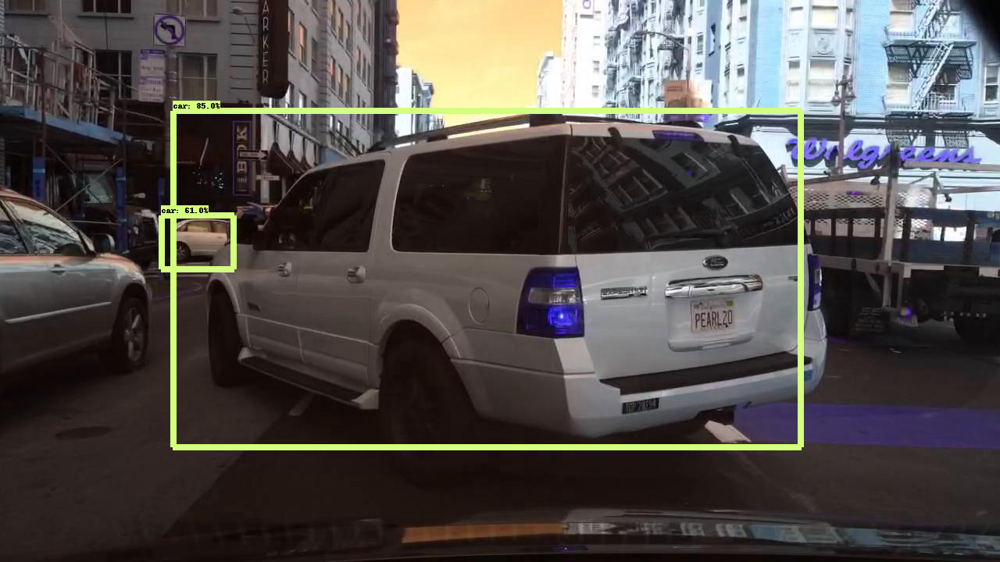

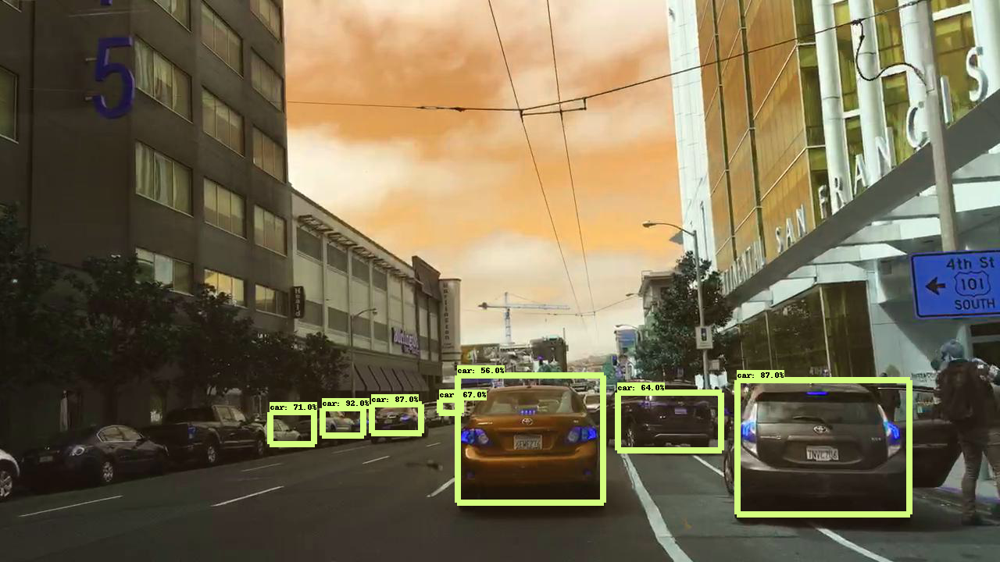

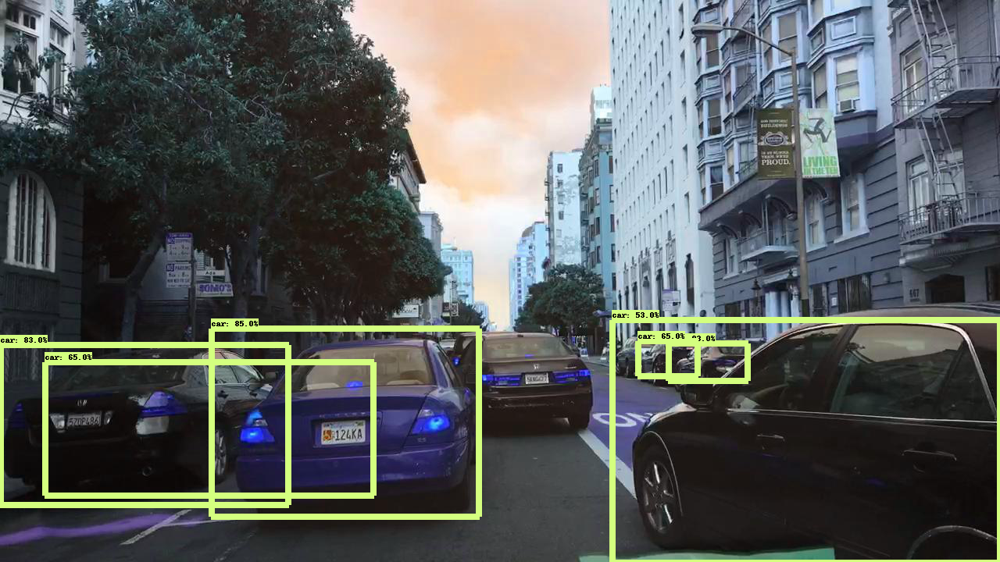

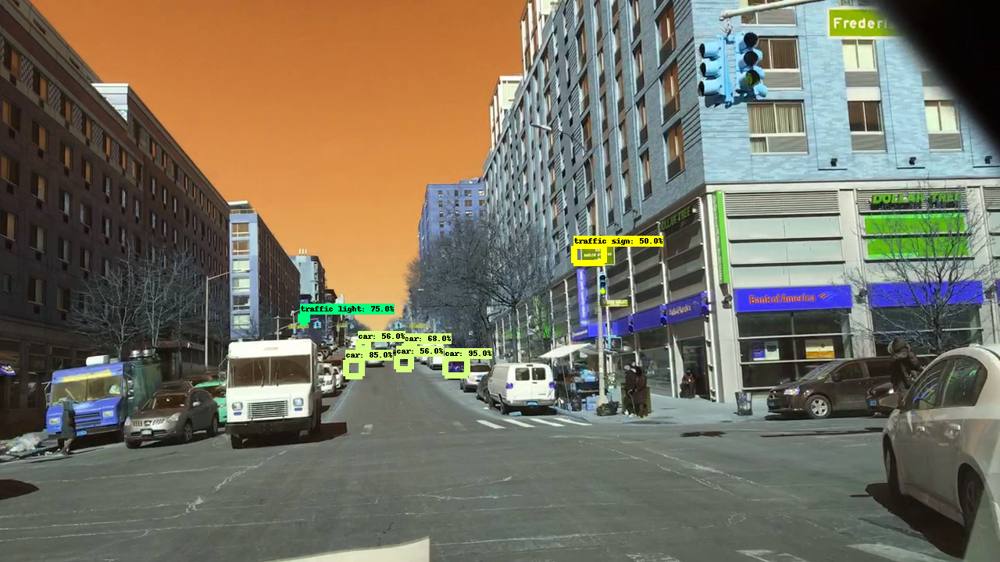

In [ ]:
from google.colab.patches import cv2_imshow

for image_path in TEST_IMAGE_PATHS:
  image = Image.open(image_path)
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = load_image_into_numpy_array(image)
  # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
  image_np_expanded = np.expand_dims(image_np, axis=0)
  # Actual detection.
  output_dict = run_inference_for_single_image(image_np, detection_graph)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks'),
      use_normalized_coordinates=True,
      line_thickness=8)
  plt.figure(figsize=IMAGE_SIZE)
  #plt.imshow(image_np)
  cv2_imshow(image_np)

## 10. Download all the contents of the runtime for backup.

In [ ]:
!zip -r transfer_learning.zip /content/ -x "/content/drive/*"

Scanning files .......................................................................................
  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2020.07.30/ (stored 0%)
  adding: content/.config/logs/2020.07.30/16.29.12.069758.log (deflated 92%)
  adding: content/.config/logs/2020.07.30/16.30.04.899171.log (deflated 54%)
  adding: content/.config/logs/2020.07.30/16.29.49.434074.log (deflated 53%)
  adding: content/.config/logs/2020.07.30/16.30.04.254570.log (deflated 55%)
  adding: content/.config/logs/2020.07.30/16.29.44.119840.log (deflated 87%)
  adding: content/.config/logs/2020.07.30/16.29.

In [ ]:
# Time left in colab session
import time, psutil
uptime = time.time() - psutil.boot_time()
remain = 12*60*60 - uptime
print(remain)

12728.06507563591


In [ ]:
!zip -r transfer_learning2.zip /content/ -x "/content/drive/*" "/content/models/bdd/images/*"

Scanning files ...............................................................
  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2020.07.30/ (stored 0%)
  adding: content/.config/logs/2020.07.30/16.29.12.069758.log (deflated 92%)
  adding: content/.config/logs/2020.07.30/16.30.04.899171.log (deflated 54%)
  adding: content/.config/logs/2020.07.30/16.29.49.434074.log (deflated 53%)
  adding: content/.config/logs/2020.07.30/16.30.04.254570.log (deflated 55%)
  adding: content/.config/logs/2020.07.30/16.29.44.119840.log (deflated 87%)
  adding: content/.config/logs/2020.07.30/16.29.30.511119.log (deflated 